# Computational Intelligence Lab 2022

In [1]:
import os
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
# Root directory for dataset
dataroot = 'data'

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# All images will be resized to this size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
!unzip /content/drive/MyDrive/data.zip

Streaming output truncated to the last 5000 lines.
  inflating: data/celeba/img_align_celeba/041248.jpg  
  inflating: data/celeba/img_align_celeba/003641.jpg  
  inflating: data/celeba/img_align_celeba/165916.jpg  
  inflating: data/celeba/img_align_celeba/057687.jpg  
  inflating: data/celeba/img_align_celeba/085413.jpg  
  inflating: data/celeba/img_align_celeba/167999.jpg  
  inflating: data/celeba/img_align_celeba/194379.jpg  
  inflating: data/celeba/img_align_celeba/117242.jpg  
  inflating: data/celeba/img_align_celeba/150356.jpg  
  inflating: data/celeba/img_align_celeba/130394.jpg  
  inflating: data/celeba/img_align_celeba/058620.jpg  
  inflating: data/celeba/img_align_celeba/200235.jpg  
  inflating: data/celeba/img_align_celeba/147667.jpg  
  inflating: data/celeba/img_align_celeba/058807.jpg  
  inflating: data/celeba/img_align_celeba/093430.jpg  
  inflating: data/celeba/img_align_celeba/132013.jpg  
  inflating: data/celeba/img_align_celeba/201530.jpg  
  inflating: d

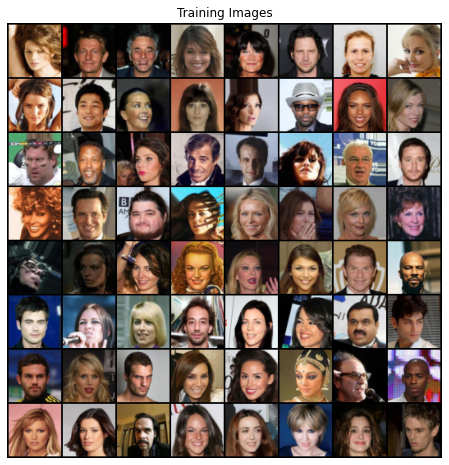

In [5]:
# Load the dataset from file and apply transformations

# Create the dataset
dataset = dset.CelebA(root=dataroot,
                      download = False,
                      transform=transforms.Compose([
                          transforms.Resize(image_size),
                          transforms.CenterCrop(image_size),
                          transforms.ToTensor(),
                          transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
# custom weights initialization called on netG and netD
def weights_init(m):
  m_class_name = m.__class__.__name__
  if 'Conv' in m_class_name:
    nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif 'BatchNorm' in m_class_name:
    nn.init.normal_(m.weight.data, 1.0, 0.02)
    nn.init.constant_(m.bias.data, 0)

In [7]:
# Generator Code

# Implement model and forward pass
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()
    #self.ngpu = ngpu
    self.main = nn.Sequential(
        # input is Z, going into a convolution
        
        nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
        nn.BatchNorm2d(ngf * 8),
        nn.ReLU(True),
        # state size. (ngf*8) x 4 x 4
        
        nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf * 4),
        nn.ReLU(True),
        # state size. (ngf*4) x 8 x 8
        
        nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf * 2),
        nn.ReLU(True),
        # state size. (ngf*2) x 16 x 16
        
        nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf),
        nn.ReLU(True),
        # state size. (ngf) x 32 x 32
        
        nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
        nn.Tanh()
        # state size. (nc) x 64 x 64
    )
  def forward(self, input):
    return self.main(input)

In [8]:
# Create the generator
netG = Generator()
netG.apply(weights_init)
netG.to(device)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [9]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()
    #self.ngpu = ngpu
    self.main = nn.Sequential(
        # input is (nc) x 64 x 64
        
        nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
        nn.LeakyReLU(0.2, inplace=True),
        
        # state size. (ndf) x 32 x 32
        nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ndf * 2),
        nn.LeakyReLU(0.2, inplace=True),
        
        # state size. (ndf*2) x 16 x 16
        nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ndf * 4),
        nn.LeakyReLU(0.2, inplace=True),
        
        # state size. (ndf*4) x 8 x 8
        nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ndf * 8),
        nn.LeakyReLU(0.2, inplace=True),
        
        # state size. (ndf*8) x 4 x 4
        nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
        nn.Sigmoid()
    )
  
  def forward(self, input):
    return self.main(input)

In [10]:
# Create the Discriminator
netD = Discriminator()
netD.apply(weights_init)
netD.to(device)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [11]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Create SummaryWriter from tensorboard
### Code Here

###

In [12]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
  # For each batch in the dataloader
  for i, data in enumerate(dataloader, 0):
    
    ############################
    # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ###########################
    
    ## Train with all-real batch
    netD.zero_grad()
    # Format batch
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, device=device)
    
    # Forward pass real batch through D
    output = netD(real_cpu).view(-1)
    # Calculate loss on all-real batch
    errD_real = criterion(output, label)
    # Calculate gradients for D in backward pass
    errD_real.backward()
    D_x = output.mean().item()
    
    ## Train with all-fake batch
    # Generate batch of latent vectors
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    
    # Generate fake image batch with G
    fake = netG(noise)
    label.fill_(fake_label)
    # Classify all fake batch with D
    output = netD(fake.detach()).view(-1)
    # Calculate D's loss on the all-fake batch
    errD_fake = criterion(output, label)
    # Calculate the gradients for this batch
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    
    # Add the gradients from the all-real and all-fake batches
    errD = errD_real + errD_fake
    
    # Update D
    optimizerD.step()

    ############################
    # (2) Update G network: maximize log(D(G(z)))
    ###########################
    
    netG.zero_grad()
    label.fill_(real_label)  # fake labels are real for generator cost
    
    # Since we just updated D, perform another forward pass of all-fake batch through D
    output = netD(fake).view(-1)
    
    # Calculate G's loss based on this output
    errG = criterion(output, label)
    
    # Calculate gradients for G
    errG.backward()
    D_G_z2 = output.mean().item()
    
    # Update G
    optimizerG.step()

    # Output training stats
    if i % 50 == 0:
      print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
      % (epoch, num_epochs, i, len(dataloader),
         errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    # Save Losses for plotting later
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    # Check how the generator is doing by saving G's output on fixed_noise
    if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
      with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
        img_list.append(torchvision.utils.make_grid(fake, padding=2, normalize=True))

    iters += 1     

Starting Training Loop...
[0/10][0/1272]	Loss_D: 1.7447	Loss_G: 5.0549	D(x): 0.5423	D(G(z)): 0.5823 / 0.0106
[0/10][50/1272]	Loss_D: 0.1263	Loss_G: 15.5048	D(x): 0.9263	D(G(z)): 0.0004 / 0.0000
[0/10][100/1272]	Loss_D: 0.6913	Loss_G: 6.7480	D(x): 0.7942	D(G(z)): 0.2046 / 0.0022
[0/10][150/1272]	Loss_D: 1.3739	Loss_G: 11.4270	D(x): 0.9332	D(G(z)): 0.6548 / 0.0001
[0/10][200/1272]	Loss_D: 0.9428	Loss_G: 9.7056	D(x): 0.9167	D(G(z)): 0.4950 / 0.0003
[0/10][250/1272]	Loss_D: 0.4204	Loss_G: 5.9106	D(x): 0.9676	D(G(z)): 0.2782 / 0.0055
[0/10][300/1272]	Loss_D: 0.7031	Loss_G: 6.7949	D(x): 0.8723	D(G(z)): 0.3587 / 0.0030
[0/10][350/1272]	Loss_D: 0.2624	Loss_G: 4.1469	D(x): 0.8679	D(G(z)): 0.0838 / 0.0338
[0/10][400/1272]	Loss_D: 0.4803	Loss_G: 3.2650	D(x): 0.8643	D(G(z)): 0.1840 / 0.0820
[0/10][450/1272]	Loss_D: 0.8313	Loss_G: 5.9769	D(x): 0.8654	D(G(z)): 0.4349 / 0.0067
[0/10][500/1272]	Loss_D: 0.9246	Loss_G: 8.6974	D(x): 0.9361	D(G(z)): 0.5056 / 0.0006
[0/10][550/1272]	Loss_D: 0.3797	Loss_G: 

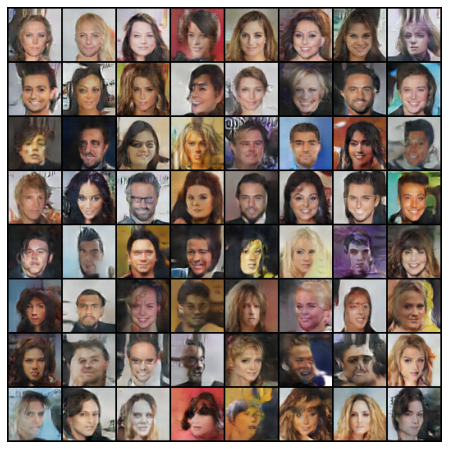

In [13]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

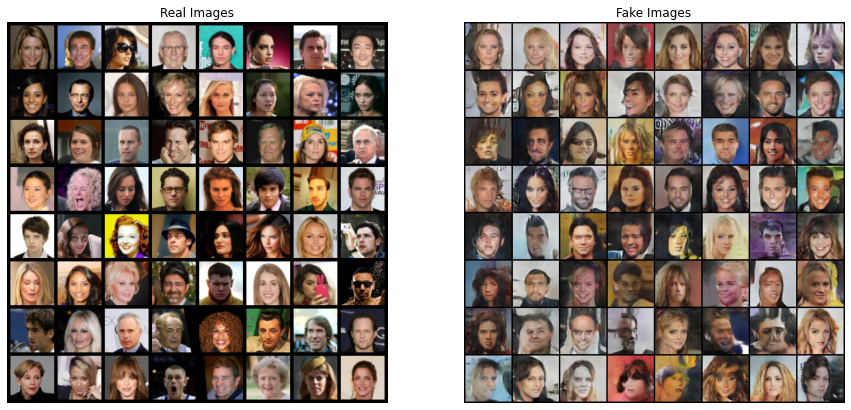

In [14]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()